# GAN

## Мотивация

GANы в их современном виде позволяют генерировать реалистичные изображения. Особенных успехов они добились в генерации лиц людей (модели семейства StyleGAN).

Попробуем научиться генерировать лица кошек.

Как вы думаете, сложнее эта задача или проще?

## Задачи
1. Скачать датасет по [этому](https://drive.google.com/file/d/1uUctCNjIXYOwx_Pl57YCEBd4Qf6-NfFm/view?usp=sharing) адресу и разархивировать его в ту же папку, где лежит ноутбук
2. Заполнить пропуски в ноутбуке
3. Настроить гиперпараметры и обучить модель так, чтобы получались адекватные результаты
4. Выбрать, реализовать и обучить до приемлемых результатов не-ванильный GAN на ваш выбор

In [ ]:
import itertools
import numpy
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from torch.utils.tensorboard import SummaryWriter
import zipfile
import os
import time
from google.colab import drive
from PIL import Image

In [ ]:
!gdown --id 1uUctCNjIXYOwx_Pl57YCEBd4Qf6-NfFm

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:132: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1uUctCNjIXYOwx_Pl57YCEBd4Qf6-NfFm
From (redirected): https://drive.google.com/uc?id=1uUctCNjIXYOwx_Pl57YCEBd4Qf6-NfFm&confirm=t&uuid=0d24a425-8164-4042-9eed-d4440e331ce1
To: /content/cats_dataset.zip
100% 30.0M/30.0M [00:00<00:00, 30.1MB/s]


In [ ]:
zip_file = 'cats_dataset.zip'
z = zipfile.ZipFile(zip_file, 'r')
z.extractall()
print(os.listdir())

['.config', 'cats_dataset.zip', 'cats_dataset', 'sample_data']


## Загрузка данных

In [ ]:
# Все изображения уже 64x64, работайте на этом разрешении
transform = torchvision.transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])
dataset = torchvision.datasets.ImageFolder(root='cats_dataset', transform=transform)

Чтение большого количества маленьких файлов с диска может стать боттлнеком для производительности обучения, так что давайте считаем их все и будем хранить в памяти. Размер датасета это позволяет.

In [ ]:
class InMemoryDataset(torch.utils.data.Dataset):
    def __init__(self, dataset):
        self.data = []
        for d in dataset:
            self.data.append(d)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        return self.data[index]

In [ ]:
dataset = InMemoryDataset(dataset)

Визуализуйте несколько изображений датасета чтобы понять, что всё правильно читается

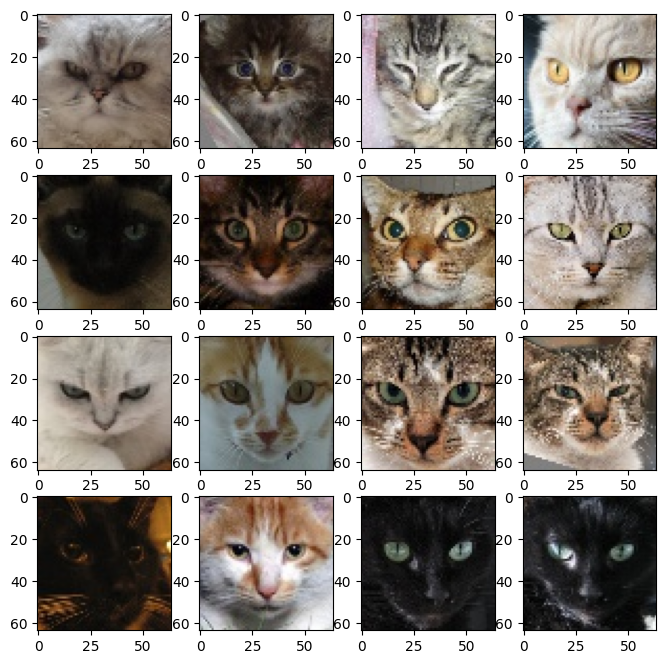

In [ ]:
plt.figure(figsize=(8, 8))
for i in range(16):
    plt.subplot(4, 4, i + 1)
    plt.imshow(numpy.transpose((dataset[i][0] + 1) / 2, (1, 2, 0)))
plt.show()

In [ ]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=32, shuffle=True, drop_last=True)

## Архитектуры сетей

Реализуйте архитектуры генератора и дискриминатора. В целом должно хватить простой архитектуры, не понадобится даже ResNet. В качестве хорошей стартовой архитектуры можно взять [DCGAN](https://paperswithcode.com/method/dcgan). Главное помните, что код нужно писать самому, и копировать его откуда бы то ни было запрещается.

Вы можете организовывать код как угодно, ниже просто предложен пример.

In [ ]:
class Generator(nn.Module):
    def __init__(self, img_size, latent_dim, channels):
        super().__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, 16 * img_size, kernel_size=4, stride=1, padding=0, bias=False),
            nn.ReLU(),
            nn.ConvTranspose2d(16 * img_size, 8 * img_size, kernel_size=4, stride=2, padding=1, bias=False),
            nn.ReLU(),
            nn.ConvTranspose2d(8 * img_size, 4 * img_size, kernel_size=4, stride=2, padding=1, bias=False),
            nn.ReLU(),
            nn.ConvTranspose2d(4 * img_size, 2 * img_size, kernel_size=4, stride=2, padding=1, bias=False),
            nn.ReLU(),
            nn.ConvTranspose2d(2 * img_size, channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, z):
        return self.model(z)

class Discriminator(nn.Module):
    def __init__(self, img_size, channels):
        super().__init__()
        self.model = nn.Sequential(
            nn.Conv2d(channels, img_size, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(img_size, 2 * img_size, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(2 * img_size, 4 * img_size, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(4 * img_size, 8 * img_size, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(img_size * 8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid(),
        )

    def forward(self, x):
        return self.model(x)


In [ ]:
# Если вы реализовываете DCGAN, не забудьте правильно инициализировать веса
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
device = 'cuda'
img_size = 64
n_channels = 3
latent_dim = 100

netG = Generator(img_size, latent_dim, n_channels).to(device)
netD = Discriminator(img_size, n_channels).to(device)
netG = netG.apply(weights_init)
netD = netD.apply(weights_init)

Создаём оптимизаторы. Обратите внимание на не-дефолтные параметры для betas, предложенные в DCGAN.

In [ ]:
lr = 0.0002
b1 = 0.5
b2 = 0.999

optimizerG = torch.optim.Adam(netG.parameters(), lr=lr, betas=(b1, b2))
optimizerD = torch.optim.Adam(netD.parameters(), lr=lr, betas=(b1, b2))

## Код обучения

Как вы помните, генератор и дискриминатор соревнуются друг с другом.

Генератор принимает на вход шум и генерирует синтетические примеры. Он обучается так, чтобы дискриминатор считал эти изображения настоящими.

Дискриминатор:
1) принимает настоящие изображения и предсказывает, что они настоящие
2) принимает сгенерированные изображения и предсказывает, что они ненастоящие

In [ ]:
# Заведём несколько переменных

# Количество обновлений дискриминатора и генератора на один шаг обучения
# Продвинутые схемы GAN варьируют это значение
Diters = 1
Giters = 1

# Метки для реальных и сгенерированных данных, использующиеся при обучении дискриминатора
label_R = 1
label_F = 0
# Метка для данных, полученных из генератора, использующаяся при обучении генератора
label_G = label_R

# Функции потерь
criterion_R = nn.BCELoss()
criterion_F = nn.BCELoss()
criterion_G = nn.BCELoss()

Предложенный код для заполнения использует tensorboard. Через него удобно контролировать процесс обучения.   
https://www.tensorflow.org/tensorboard/get_started    

Для запуска tensorboard используйте команду:
`tensorboard --logdir .`

Смотреть визуализации можно будет в браузере по дефолтному адресу [localhost:6006](localhost:6006).

В Google Colab такое не сработает, но есть cell magic `%tensorboard --logdir logs`, открывающая tensorboard в ячейке ноутбука.

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
# Зацикливаем даталоадер, чтобы можно было набирать произвольное количество батчей каждый шаг
data_iter = itertools.cycle(iter(dataloader))

# Для визуализации метрик и изображений
realtb = SummaryWriter("logs/real")
faketb = SummaryWriter("logs/fake")

# Зададим параметры обучения
n_epochs = 40
sample_interval = 50
idx = 0
for epoch in range(n_epochs):
    for i in range(len(dataloader)):
        steps_done = epoch * len(dataloader) + i

        # Обучение дискриминатора
        j = 0
        while j < Diters:
            j += 1

            real, _ = next(data_iter)
            real = real.to(device)
            bs = real.shape[0]

            optimizerD.zero_grad()

            # обучение на реальных данных
            real_target = torch.full((bs,), label_R, device=device).float()
            outD_real = netD(real).view(-1)
            errD_real = criterion_R(outD_real, real_target)
            errD_real.backward()

            # обучение на сгенерированных данных
            noise = torch.randn(bs, latent_dim, 1, 1, device=device)
            fake = netG(noise)
            fake_target = torch.full((bs,), label_F, device=device).float()
            outD_fake = netD(fake.detach()).view(-1)
            errD_fake = criterion_F(outD_fake, fake_target)
            errD_fake.backward()

            errD = errD_real + errD_fake

            optimizerD.step()

        # Обучение генератора
        j = 0
        while j < Giters:
            j += 1

            optimizerG.zero_grad()

            noise = torch.randn(bs, latent_dim, 1, 1, device=device)

            fake = netG(noise)

            outG = netD(fake).view(-1)
            gen_target = torch.full((bs,), label_G, device=device).float()
            errG = criterion_G(outG, gen_target)
            errG.backward()

            optimizerG.step()


        if steps_done % sample_interval == 0:
            with torch.no_grad():
                realtb.add_image("real", torchvision.utils.make_grid(real[:24], normalize=True), global_step=idx)
                faketb.add_image("fake", torchvision.utils.make_grid(fake[:24], normalize=True), global_step=idx)
            idx += 1

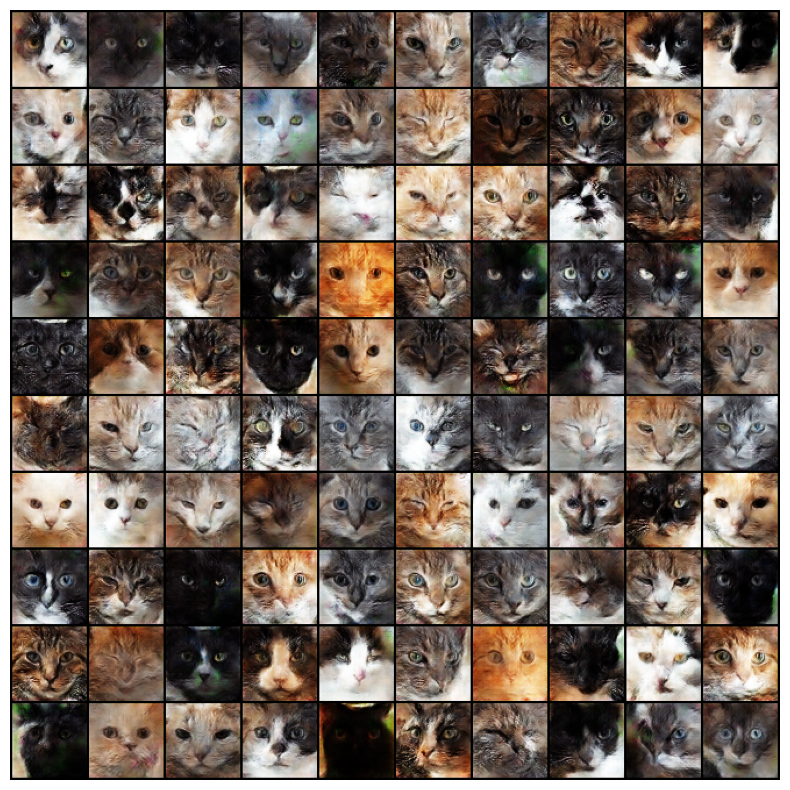

In [ ]:
from torchvision.utils import save_image

batch_size = 100

noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
with torch.no_grad():
    generated_images = netG(noise)

# Сохраняем и выводим сгенерированные изображения
save_image(generated_images, 'generated_images.png', nrow=10, normalize=True)

# Выводим сгенерированные изображения
img = Image.open('generated_images.png')
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.axis('off')
plt.show()


"Ванильные" GANы трудны в обучении, и исследователи выработали набор "хаков" (см. https://github.com/soumith/ganhacks). Вы можете воспользоваться ими, чтобы получить более хорошие результаты.

Поскольку у нас учебное задание, здесь "успехом" будем считать, если по крайней мере в 60% генерирующихся картинок будет понятно, что изображён кот, и не будет сильно бросающихся в глаза артефактов.

Есть ли какие-нибудь артефакты у изображения? Опишите их. Как вы думаете, почему они возникли (архитектура сетей, используемый лосс, ...)?

**Ваш ответ:** Некоторые изображения содержат искажения формы, такие как неестественные пропорции глаз или ушей, или всего лица, что может быть вызвано недостаточным разнообразием в обучающем наборе


Ссылка на 100 примеров генерации: <https://photos.app.goo.gl/*6pppumuXVDdTn3ec9*>

## (Дополнительно) Обучение не-ванильных GAN

Ещё один способ улучшить результаты - использовать более современную функцию потерь, которая не имеет таких проблем, как ванильный GAN.

Выберите любой из вариантов (WGAN, WGAN-GP, Geometric GAN, ...) и попробуйте обучить сеть, используя данный лосс и методы.

Обязательно приведите здесь в ноутбуке весь код обучения и примеры генерирующихся картинок.

Попробуем обучить WGAN!

In [ ]:
class Generator(nn.Module):
    def __init__(self, img_size, latent_dim, channels):
        super().__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, 16 * img_size, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(16 * img_size),
            nn.ReLU(),
            nn.ConvTranspose2d(16 * img_size, 8 * img_size, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(8 * img_size),
            nn.ReLU(),
            nn.ConvTranspose2d(8 * img_size, 4 * img_size, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(4 * img_size),
            nn.ReLU(),
            nn.ConvTranspose2d(4 * img_size, 2 * img_size, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(2 * img_size),
            nn.ReLU(),
            nn.ConvTranspose2d(2 * img_size, channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, z):
        return self.model(z)

class Discriminator(nn.Module):
    def __init__(self, img_size, channels):
        super().__init__()
        self.model = nn.Sequential(
            nn.Conv2d(channels, img_size, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(img_size, 2 * img_size, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(2 * img_size, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv2d(2 * img_size, 4 * img_size, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(4 * img_size, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv2d(4 * img_size, 8 * img_size, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(8 * img_size, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv2d(img_size * 8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid(),
        )

    def forward(self, x):
        return self.model(x)


In [ ]:
device = 'cuda'
img_size = 64
n_channels = 3
latent_dim = 100

netG = Generator(img_size, latent_dim, n_channels).to(device)
netD = Discriminator(img_size, n_channels).to(device)
netG = netG.apply(weights_init)
netD = netD.apply(weights_init)

In [ ]:
lr = 0.00005

optimizerG = torch.optim.RMSprop(netG.parameters(), lr=lr)
optimizerD = torch.optim.RMSprop(netD.parameters(), lr=lr)

In [ ]:
%tensorboard --logdir logs2

<IPython.core.display.Javascript object>

In [ ]:
# Зацикливаем даталоадер, чтобы можно было набирать произвольное количество батчей каждый шаг
data_iter = itertools.cycle(iter(dataloader))

# Для визуализации метрик и изображений
realtb = SummaryWriter("logs2/real")
faketb = SummaryWriter("logs2/fake")

# Зададим параметры обучения
n_epochs = 20 # Запустил эту ячейку два раза, для сравнения с DCGAN
sample_interval = 50
idx = 0

for epoch in range(n_epochs):
    for i in range(len(dataloader)):
        steps_done = epoch * len(dataloader) + i

        j = 0
        while j < Diters:
            j += 1
            optimizerD.zero_grad()
            real, _ = next(data_iter)
            real = real.to(device)
            bs = real.shape[0]

            # обучение на реальных данных
            outD_real = netD(real).view(-1)
            errD_real = -torch.mean(outD_real)
            errD_real.backward(retain_graph=True)

            # обучение на сгенерированных данных
            noise = torch.randn(bs, latent_dim, 1, 1, device=device)
            fake = netG(noise)
            outD_fake = netD(fake.detach()).view(-1)
            errD_fake = torch.mean(outD_fake)
            errD_fake.backward()

            optimizerD.step()

            for p in netD.parameters():
                p.data.clamp_(-0.01, 0.01)

        optimizerG.zero_grad()

        noise = torch.randn(bs, latent_dim, 1, 1, device=device)

        fake = netG(noise)

        outG = netD(fake).view(-1)
        errG = -torch.mean(outG)
        errG.backward()
        optimizerG.step()

        if steps_done % sample_interval == 0:
            with torch.no_grad():
                realtb.add_image("real", torchvision.utils.make_grid(real[:24], normalize=True), global_step=idx)
                faketb.add_image("fake", torchvision.utils.make_grid(fake[:24], normalize=True), global_step=idx)
            idx += 1


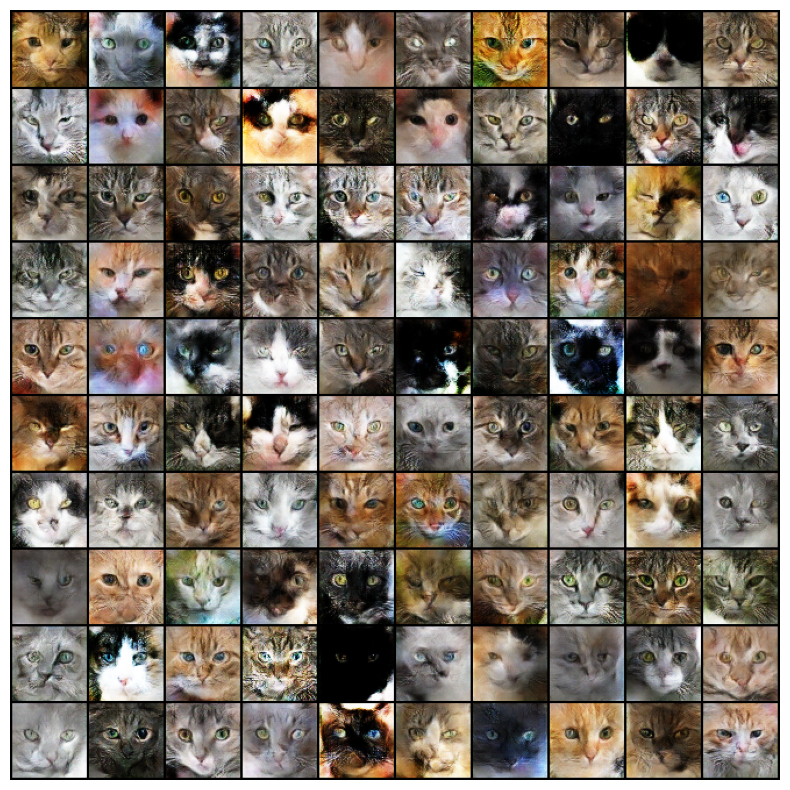

In [ ]:
batch_size = 100

noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
with torch.no_grad():
    generated_images = netG(noise)

# Сохраняем и выводим сгенерированные изображения
save_image(generated_images, 'generated_images2.png', nrow=10, normalize=True)

# Выводим сгенерированные изображения
img = Image.open('generated_images2.png')
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.axis('off')
plt.show()


Помогло ли это улучшить качество картинок? Стабилизировать / упростить обучение?

**Ваш ответ:** WGAN имеет меньше гиперпараметров, что делает его обучение легче. Обучение стало стабильнее